# Analyse der Tweets von Bundestagsabgeordneten
## 1. Dataset preparation

In [1]:
import pymongo

client = pymongo.MongoClient("mongodb://localhost:27017/")

db = client['Twitter']
All_Tweets_collection = db['twitter_mdp_ex_date_proj']


In [2]:
import pandas as pd
import pymongo
import datetime

pd.set_option('display.max_colwidth', 0)

# sample_df = pd.DataFrame(list(All_Tweets_collection.aggregate([ {"$sample": {"size": 50 }}], 
#                                      allowDiskUse=True
#                                    )))

time_sample_df = pd.DataFrame(list(All_Tweets_collection.find( {
            'created_at_datetime': {'$gte': datetime.datetime(2017,1,1,0,0,0),
                                    '$lt': datetime.datetime(2020,5,31,0,0,0)},
            'retweeted_id': None
            })
        ))

In [3]:
time_sample_df = time_sample_df.drop(['partei'], axis=1)
time_sample_df.head(2)

,_id,created_at,id,full_text,is_quote_status,retweet_count,lang,created_at_datetime,user_id,user_name,user_screen_name,user_location,user_description,user_followers_count,user_friends_count,user_created_at,user_party
0,5e954cff7973ce357347fb0f,Fri Feb 22 15:10:38 +0000 2019,1098963281329438720,Alles schon geregelt https://t.co/rPsmex9emf,True,0,de,2019-02-22 15:10:38,1098889251515703296,BystronAFD,AfdBystron,,Satire Account,9,41,Fri Feb 22 10:16:28 +0000 2019,AFD
1,5e954cff7973ce357347fb1c,Fri Feb 22 14:37:27 +0000 2019,1098954928960274432,Herr Schneider es sind 11% und wer hat bisher in der CDU das sagen gehabt? Eine Frau! Jetzt müssen wieder gestandene Männer an die Macht! Die AFD wird das 2020 machen https://t.co/96pGx1vZNw,True,0,de,2019-02-22 14:37:27,1098889251515703296,BystronAFD,AfdBystron,,Satire Account,9,41,Fri Feb 22 10:16:28 +0000 2019,AFD


In [26]:
%%html
<style>
table {float:left}
</style>

## Übersicht der Tweets pro Partei 

Gibt es Namen die keiner Partei zugeordnet werden konnten?
* AfdBystron - Satire Account
* EspendillerM - Name geändert wegen Dr. Titel

*Müssen bei nächstem Datenbank- Update angepasst werden*


##### Beispiel für die Übersicht für Tweets im Zeitraum 01.01.2019 - 10.05.2020

|Partei  |  Tweets |      |mdp gesamt|mdp Twitter|Anteil Twitter user|Tweets pro user
|--------|---------|      |----------|-----------|----------|---------------
|AFD     |  12959  |      |89        |26         |29,21     |498
|FDP     |  47759  |      |80        |69         |86,25     |692
|Gruene  |  39910  |      |67        |57         |85,07     |700
|Linke   |  36422  |      |69        |49         |71,01     |743
|SPD     |  44520  |      |152       |102        |67,11     |436
|Union   |  39979  |      |246       |122        |49,59     |328


##### Entferne Tweets ohne Parteizuordnung

Nach der Überarbeitung der Namenslisten (manuelle Suche auf Twitter), wurden die folgenden "Namen" aus Listen entfernt, für die jedoch Tweets in der Datenbank stehen.

* AfdBystron       -- aus mongodb entfernen
* cducsubt         -- aus mongodb entfernen
* fdpbt            -- aus mongodb entfernen
* kahrs            -- Collection "parteizuordnung" um diesen Politiker + Partei ergänzen
* BabettesChefin   -- aus mongodb entfernen ("twittert nicht mehr. „Nicht meine Politik-Kommunikation!“)
* ruppert_stefan   -- Collection "parteizuordnung" um diesen Politiker + Partei ergänzen
* PetrBystronAfD   -- Muss in normale Liste mit aufgenommen werden! (== aktueller Account)
* EspendillerM     -- Collection "parteizuordnung" um diesen Politiker + Partei ergänzen

In [4]:
# no_party = time_sample_df[time_sample_df.user_party.isnull()].user_screen_name
# for i in set(no_party):
#     print(i)

sample_df = time_sample_df[time_sample_df.user_party.isnull()== False]
len(sample_df['user_screen_name'])

410898

##### Felder zur Betrachtung auf Tagesebene und Wochenebene 

In [13]:
date = []
for timestamp in sample_df.created_at_datetime:
    date.append(timestamp.date())
      
sample_df.loc[:, ('date')] = date
sample_df.loc[:,('month')] = sample_df.created_at_datetime.dt.strftime('%y-%m')
# mdp_tweets.loc[:,('week')] = mdp_tweets.created_at_datetime.dt.weekofyear
# mdp_tweets.loc[:,('week')] = mdp_tweets.created_at_datetime.dt.strftime('%y-w%V')

#### Unterteilung in Bins und erstellen eines Dictionarys für Zeiträume

In [88]:
# # Sortieren nach Datum/Zeit
# sample_df = sample_df.sort_values(by = ['created_at_datetime'])

# # Zerschneiden in Bins
# sample_df['bins'] = pd.cut(sample_df['created_at_datetime'], bins=70, labels=list(range(1,71)))

# labels=list(range(1,71))
# weeks = {}
    
# for i in labels:
#     weeks['week_'+str(i)] = sample_df[sample_df['bins'] == i]    

# bin_sum_per_week = {}

# for label in range(1,71): 
#     df = sample_df[sample_df['bins'] == label]
#     head = list(df.created_at_datetime.head(1))[0]
#     tail = list(df.created_at_datetime.tail(1))[0]
#     bin_sum_per_week[label] = {}
#     bin_sum_per_week[label]['Von'] = head
#     bin_sum_per_week[label]['Bis'] = tail
# bin_sum_per_week


#### Erstellen eines Dictionary für Parteizugehörikgeit

In [14]:
partei_dic = {}
parteien = ['Union', 'SPD', 'Gruene', 'Linke', 'FDP', 'AFD']

for partei in parteien:
    partei_dic['tweets_'+ partei] = sample_df[sample_df['user_party'] == partei]  

# Explorative Daten Analyse (EDA) - nach Partei gegliedert
## 1.) Allgemeine Übersicht
##### Eingrenzung der relevanten Spalten

In [15]:
mdp_tweets = sample_df[['created_at_datetime', 'date' ,'month', 'user_screen_name','user_party', 'full_text']]
#mdp_tweets.tail()

##### Eingrenzung der relevanten Zeilen

In [13]:
# mdp_tweets = mdp_tweets.loc[(mdp_tweets['created_at_datetime'] < datetime.datetime(2020,1,1,0,0,0)) & (mdp_tweets['created_at_datetime'] >= datetime.datetime(2019,1,1,0,0,0))]

##### Pivotierung
* Wie viel hat welche Partei an welchem Tag getwittert?
* Wie viel haben die Mitglieder einer Partei in best. Zeiraum getwittert?
* Wie viel hat ein best Mitglied an welchem Tag getwittert?

In [16]:
import numpy as np
mdp_partei = mdp_tweets[['user_party', 'date', 'month', 'user_screen_name', 'full_text']]
partei_piv = pd.pivot_table(mdp_partei, columns = ['user_party'], index = ['month'], aggfunc = np.count_nonzero)
partei_piv['full_text'].tail()
# partei_Piv = partei_piv['full_text']
# partei_Piv.groupby('week').sum()

user_party,AFD,FDP,Gruene,Linke,SPD,Union
month,,,,,,
20-01,1718,3202,2579,2515,2649,2555
20-02,2373,3363,2809,3046,3485,2599
20-03,2238,4199,3719,3569,3817,3305
20-04,1618,3815,3129,2866,3106,2575
20-05,1764,3483,2888,1877,2980,3278


In [17]:
partei_piv_dic = {}

for partei in parteien:
    partei_mdp = mdp_tweets[mdp_tweets['user_party'] == partei]
    patei_names = partei_mdp[['user_screen_name', 'date']]
    partei_piv_dic[partei] = pd.pivot_table(patei_names, index = 'user_screen_name', aggfunc = np.count_nonzero )
    
partei_piv_dic['Gruene'].head()

,date
user_screen_name,
ABaerbock,937
BeateWaRo,504
BriHasselmann,1893
ChrisKuehn_mdb,651
DJanecek,2136


In [18]:
name_piv_dic = {}
    
for partei in parteien:
    partei_mdp = mdp_tweets[mdp_tweets['user_party'] == partei]
    partei_names = partei_mdp[['user_screen_name', 'date']]
    for name in set(partei_names['user_screen_name']):
        name_piv = pd.pivot_table(partei_names[partei_names['user_screen_name'] == name], index = 'date', aggfunc = np.count_nonzero)
        name_piv_dic[name] = name_piv
# name_piv_dic['StBrandner'].head(5)

### Erstelle Übersichtstabelle 

In [19]:
mdp_gesamt = [246, 152, 67, 69, 80, 89] # https://www.bundestag.de/parlament/plenum/sitzverteilung_19wp

tweets_piv = pd.pivot_table(mdp_partei, index = 'user_party', aggfunc = np.count_nonzero )['full_text']
Tweets = []
for partei in parteien:
    Tweets.append(tweets_piv[partei])

mdp_Twitter = []
for partei in parteien:
    mdp_Twitter.append(len(partei_piv_dic[partei]))

summary_df = pd.DataFrame({'user_party':parteien, 'Tweets': Tweets, 'mdp_gesamt': mdp_gesamt, 'mdp_Twitter': mdp_Twitter})
summary_df['Anteil_Twitter_user'] = round(summary_df['mdp_Twitter']/summary_df['mdp_gesamt']*100, 2)
summary_df['Tweets_pro_user'] = round(summary_df['Tweets']/summary_df['mdp_Twitter'])
summary_df.index = summary_df['user_party']
summary_df = summary_df.drop(columns = 'user_party')
summary_df


,Tweets,mdp_gesamt,mdp_Twitter,Anteil_Twitter_user,Tweets_pro_user
user_party,,,,,
Union,73415,246,136,55.28,540.0
SPD,86565,152,115,75.66,753.0
Gruene,74295,67,60,89.55,1238.0
Linke,63508,69,51,73.91,1245.0
FDP,67038,80,74,92.50,906.0
AFD,46077,89,76,85.39,606.0


In [194]:
# #name_piv_dic['StBrandner'][name_piv_dic['StBrandner'].index == datetime.date(2020,2,6)]
# for tweet in mdp_partei.index:
#     if((mdp_partei['user_screen_name'][tweet] == 'StBrandner') and mdp_partei['date'][tweet] == datetime.date(2020,5,3)):
#         #print(mdp_partei['date'][tweet])
#         print(mdp_partei['full_text'][tweet])


## 2.) Grafen zur Menge von Tweets über die Zeit

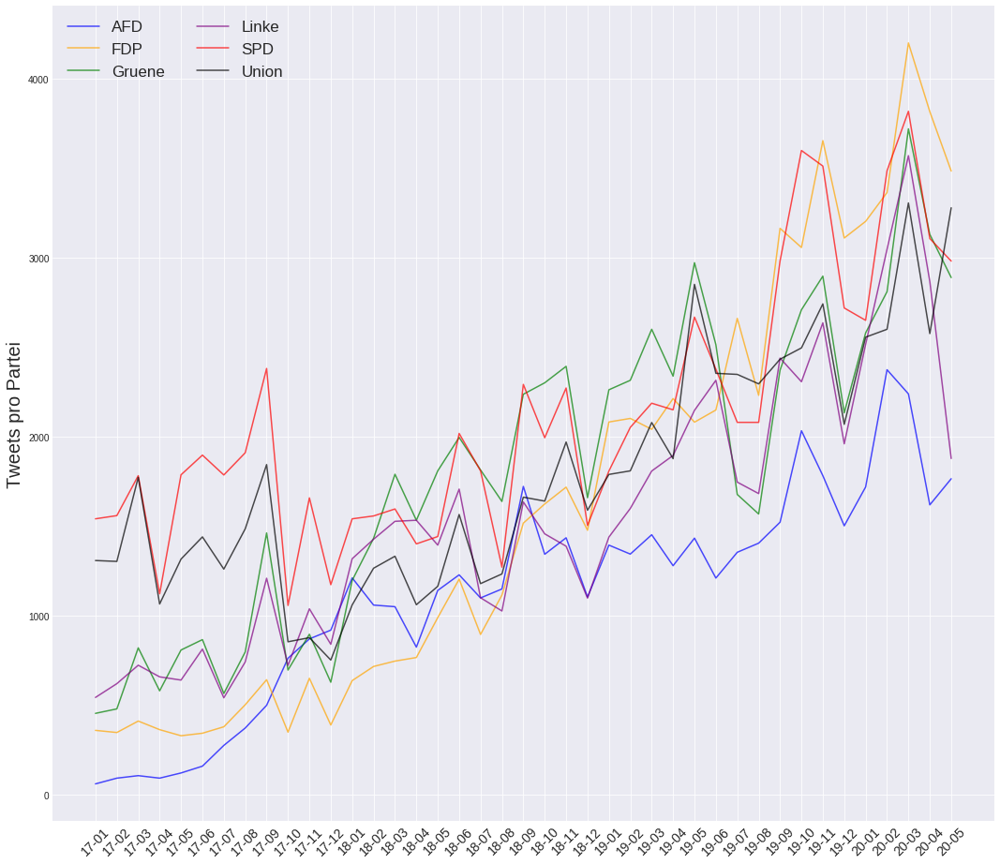

In [20]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd
import numpy as np

plt.style.use('seaborn-darkgrid')
my_palette = ['blue', 'orange', 'green', 'purple', 'red', 'black']

fig = plt.figure(figsize = (18, 16))
ax = fig.add_subplot(111)

num=0
for column in partei_piv['full_text']:
    ax.plot(partei_piv.index, partei_piv['full_text'][column], color = my_palette[num], alpha=0.7, label = column)
    num+=1
    
ylab = ax.set_ylabel('Tweets pro Partei', size = 20)
# = ax.set_xlabel('Datum', size = 20)
plt.legend(loc = 2, ncol = 2, fontsize = 17)

# y_tags
# ytag = ax.set_yticklabels(np.arange(partei_piv.values.min()-51, partei_piv.values.max()+50, 50), fontsize = 18)
# ytag = ax.set_yticklabels(np.arange(partei_piv.values.min()-90, partei_piv.values.max(), 200), fontsize = 18)

#x_tags
xtag = ax.set_xticklabels(partei_piv.index, fontsize = 14, rotation = 45)

# months = mdates.MonthLocator()
# months_fmt = mdates.DateFormatter('%b-%Y')

# ax.xaxis.set_major_locator(months)
# ax.xaxis.set_major_formatter(months_fmt)





In [50]:
pd.set_option('display.max_rows', None)
mdp_tweets.loc[(mdp_tweets.date <= datetime.date(2019,12,31)) 
               & (mdp_tweets.date >= datetime.date(2019,12,1))
               & (mdp_tweets.user_party == 'AFD')
               # & (mdp_tweets.user_screen_name == 'StBrandner')
              ]

,created_at_datetime,date,month,user_screen_name,user_party,full_text
179,2019-12-31 12:27:40,2019-12-31,19-12,StBrandner,AFD,Auf das nächste erfolgreiche #AfD-Jahr: #2020! 🤗 🚀🚀🚀\n#Berlin #Bundestag #Brandner #Thüringen #Gera #GewinnerStadt #Erfurt #Weimar #Grammetal #WK193 #Jena #Sömmerda #nurnochAfD https://t.co/RJxRsKkNPn
180,2019-12-31 11:01:36,2019-12-31,19-12,StBrandner,AFD,#Brandnerfragtnach: Was plant die Bundesregierung noch alles im K(rampf) gegen Rechts?\nhttps://t.co/W9rFAn3SEW\n#passwortherausgabe #hassundhetze #hasskriminalität #unbestimmterechtsbegriffe #afdwirkt #brandnerfragt #berlin #bundestag #brandner https://t.co/3xCMFd1BLq
181,2019-12-30 19:11:49,2019-12-30,19-12,StBrandner,AFD,#LexBrandner... usw... https://t.co/Db8jP6owGf
182,2019-12-30 08:25:52,2019-12-30,19-12,StBrandner,AFD,#KrampfgegenRechts #AAS #IDZ...😡\nhttps://t.co/UM3LeAK0ME
183,2019-12-23 20:36:00,2019-12-23,19-12,StBrandner,AFD,So devot kenne Herrn Wieduwilt ansonsten gar nicht...\n#eineKräheandereKrähe https://t.co/ulglEIjVI1
184,2019-12-23 20:14:30,2019-12-23,19-12,StBrandner,AFD,... und für mich sind #Linke #Mörder! https://t.co/yJKWGoBHg9
185,2019-12-22 20:27:23,2019-12-22,19-12,StBrandner,AFD,"„Die anwesenden Jugendlichen hatten überwiegend die deutsche Staatsbürgerschaft, teilte die Polizei mit. Ihnen wurden im Anschluss Platzverweise ausgesprochen, (...).“ 🤔 https://t.co/ezd3L08ugT"
186,2019-12-22 08:06:23,2019-12-22,19-12,StBrandner,AFD,🕯 🕯 🕯 🕯\n#Adventssonntag
187,2019-12-20 21:34:09,2019-12-20,19-12,StBrandner,AFD,"Und Spesenritter, Herr Luczak?🤔 https://t.co/c2636vBAf8"
188,2019-12-19 09:52:53,2019-12-19,19-12,StBrandner,AFD,"Vor einem Jahr...\n... aber ganz aktuell, denn morgen (20.12.2019!) werden wir - und noch einige mehr😎 - da auch sein!\n#Erfurt #Weihnachtsmarkt #Weimar #Grammetal #WK193 #Brandner #Brandnerunterwegs https://t.co/Rm4sXh0doY"


In [24]:
mdp_tweets.columns

Index(['created_at_datetime', 'date', 'month', 'user_screen_name',
       'user_party', 'full_text'],
      dtype='object')

## 3.) Einfache Textanalysen
##### Text Cleaning

In [58]:
# Load the regular expression library
pd.set_option('display.max_colwidth', 0)
import re

def remove_emoji(string):
    emoji_pattern = re.compile("["
                           u"\U0001F600-\U0001F64F"  # emoticons
                           u"\U0001F300-\U0001F5FF"  # symbols & pictographs
                           u"\U0001F900-\U0001F9FF"  # https://www.compart.com/de/unicode/block/U+1F900
                           u"\U0001F680-\U0001F6FF"  # transport & map symbols
                           u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
                           u"\U00002702-\U000027B0"
                           u"\U000024C2-\U0001F251"
                           "]+", flags=re.UNICODE)
    return emoji_pattern.sub(r'', string)


# Remove punctuation
sample_df.loc[:,('full_text_processed')] = sample_df.loc[:,('full_text')].map(lambda x: re.sub('[,\.!?#@\\n"“„\:;&\(\)]', '', x))
# Remove Links
sample_df.loc[:,('full_text_processed')] = sample_df.loc[:,('full_text_processed')].map(lambda x: re.sub('http.*', '', x))

sample_df.loc[:,('full_text_processed')] = sample_df.loc[:,('full_text_processed')].map(lambda x: re.sub('amp', '', x))
# Convert the titles to lowercase
#sample_df['full_text_processed'] = sample_df['full_text_processed'].map(lambda x: x.lower())

#sample_df['full_text_processed'] = sample_df['full_text_processed'].map(lambda x: remove_emoji(x))
# Print out the first rows of papers
sample_df['full_text_processed'].head(200)

0      Alles schon geregelt                                                                                                                                                                                                                                                                     
1      Herr Schneider es sind 11% und wer hat bisher in der CDU das sagen gehabt Eine Frau Jetzt müssen wieder gestandene Männer an die Macht Die AFD wird das 2020 machen                                                                                                                      
2      Deshalb fordern wir auf Autobahnen ein Tempolimet von 80 Stundenkilometern                                                                                                                                                                                                               
3      Wer will dich denn schon bedrohen Linke Socke                                                                                 

##### Durchsuche Datensatz nach bestimmten Tweets und sortiere aus

In [96]:
# Print words that match certain words:
#sample_df['full_text_processed'][sample_df['full_text_processed'].str.match(r'.*brexit.*')==True]

# Remove Tweets that match certain words:
# sample_df = sample_df[~sample_df.full_text_processed.str.contains("fröhlicher gruss")]
# sample_df.groupby('user_party').size()

##### Stopwords

In [86]:
#from stop_words import get_stop_words
#stop_words = get_stop_words('de')

import stopwordsiso as stopwords
stop_words = list(stopwords.stopwords(["de"])) 

mehr_sw = ['der', 'die', 'das', 'Das', 'the', 'ist' 'es', 'gibt', 'und', 'für', 'auf', 'aus', 'mit', 'dem', 'tb', 'cducsubt', 'spdbt', 'fdpbt', 'sdpde']
for word in mehr_sw:
    stop_words.append(word)
    


# Wordclouds
#### Basic

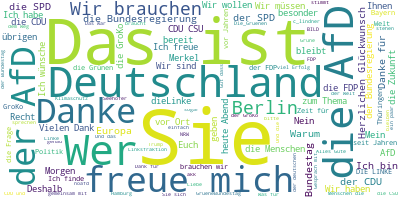

In [97]:
from wordcloud import WordCloud

# Join the different processed titles together.
long_string = ','.join(sample_df['full_text_processed'])
# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
# Generate a word cloud
wordcloud.generate(long_string)
# Visualize the word cloud
wordcloud.to_image()

#### Wordcloud zu bestimmtem Zeitunkt

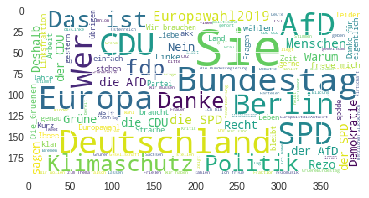

In [103]:
from wordcloud import WordCloud

sample_df_date = sample_df.loc[(sample_df['created_at_datetime'] <= datetime.datetime(2019,6,8,0,0,0)) & (sample_df['created_at_datetime'] >= datetime.datetime(2019,5,15,0,0,0))]

# Join the different processed titles together.
long_string = ','.join(sample_df_date['full_text_processed'])
# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
# Generate a word cloud
wordcloud.generate(long_string)
# Visualize the word cloud
plt.imshow(wordcloud)

### Wöchentliche Wordcloud - Union

Text(0.5, 1.01, 'Union_Tweets')

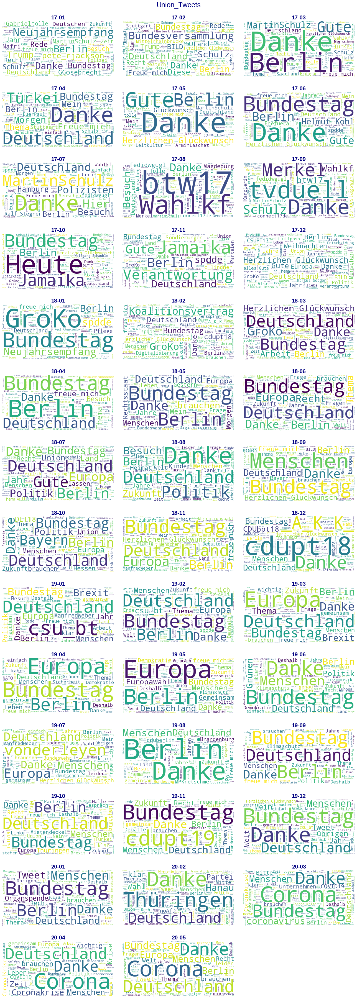

In [200]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'Union'
sample_df_partei = sample_df[sample_df.user_party == party]

sample_df_month = list(set(sample_df_partei['month']))
sample_df_month.sort()

date_dic_partei = {}
   
for month in sample_df_month:
    date_dic_partei[month] = sample_df_partei[sample_df_partei['month'] == month]

    
def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=4)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 50))

for month, n in zip(date_dic_partei, range(1,len(date_dic_partei.keys())+1)):
    title = month

    ax = fig.add_subplot(14,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    long_string = ','.join(date_dic_partei[month]['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.01)

### Wöchentliche Wordcloud - AFD

Text(0.5, 1.01, 'AFD_Tweets')

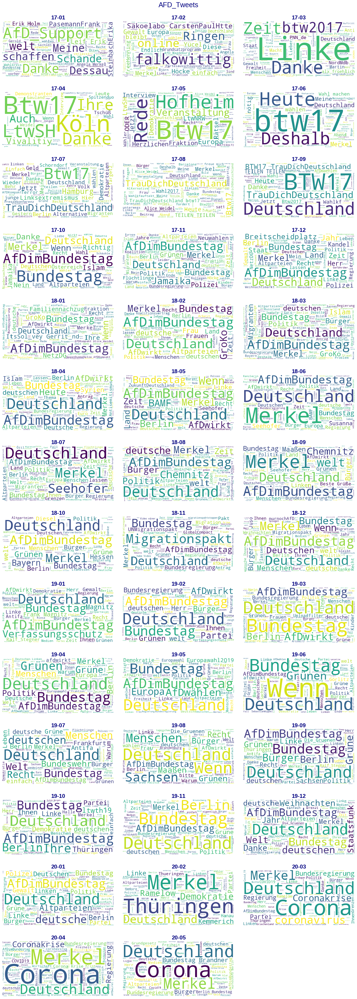

In [195]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'AFD'

sample_df_partei = sample_df[sample_df.user_party == party]

sample_df_month = list(set(sample_df_partei['month']))
sample_df_month.sort()

date_dic_partei = {}
   
for month in sample_df_month:
    date_dic_partei[month] = sample_df_partei[sample_df_partei['month'] == month]

    
def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=4)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 50))

for month, n in zip(date_dic_partei, range(1,len(date_dic_partei.keys())+1)):
    title = month

    ax = fig.add_subplot(14,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    long_string = ','.join(date_dic_partei[month]['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.01)

### Wöchentliche Wordcloud - SPD

Text(0.5, 1.01, 'SPD_Tweets')

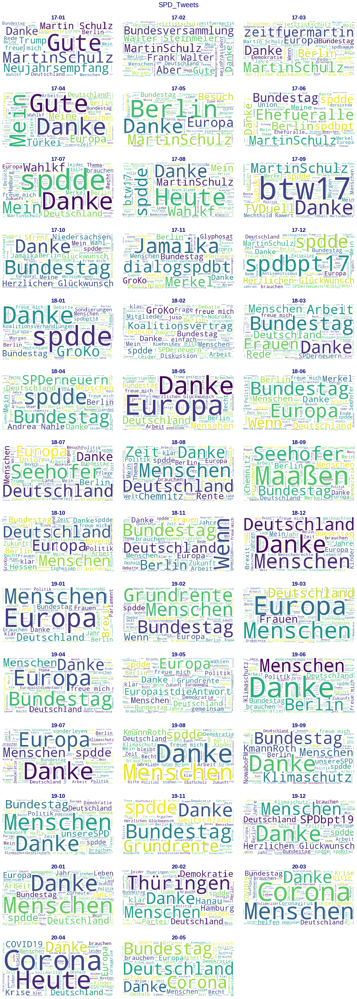

In [199]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'SPD'

sample_df_partei = sample_df[sample_df.user_party == party]

sample_df_month = list(set(sample_df_partei['month']))
sample_df_month.sort()

date_dic_partei = {}
   
for month in sample_df_month:
    date_dic_partei[month] = sample_df_partei[sample_df_partei['month'] == month]

    
def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=4)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 50))

for month, n in zip(date_dic_partei, range(1,len(date_dic_partei.keys())+1)):
    title = month

    ax = fig.add_subplot(14,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    long_string = ','.join(date_dic_partei[month]['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.01)

### Wöchentliche Wordcloud - Grüne

Text(0.5, 1.01, 'Gruene_Tweets')

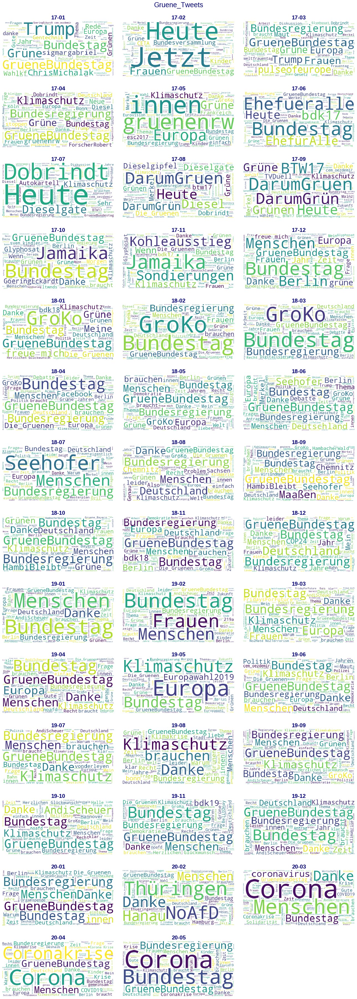

In [196]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'Gruene'

sample_df_partei = sample_df[sample_df.user_party == party]

sample_df_month = list(set(sample_df_partei['month']))
sample_df_month.sort()

date_dic_partei = {}
   
for month in sample_df_month:
    date_dic_partei[month] = sample_df_partei[sample_df_partei['month'] == month]

    
def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=4)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 50))

for month, n in zip(date_dic_partei, range(1,len(date_dic_partei.keys())+1)):
    title = month

    ax = fig.add_subplot(14,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    long_string = ','.join(date_dic_partei[month]['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.01)

### Wöchentliche Wordcloud - Linke

In [ ]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'Linke'

sample_df_partei = sample_df[sample_df.user_party == party]

sample_df_month = list(set(sample_df_partei['month']))
sample_df_month.sort()

date_dic_partei = {}
   
for month in sample_df_month:
    date_dic_partei[month] = sample_df_partei[sample_df_partei['month'] == month]

    
def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=4)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 50))

for month, n in zip(date_dic_partei, range(1,len(date_dic_partei.keys())+1)):
    title = month

    ax = fig.add_subplot(14,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    long_string = ','.join(date_dic_partei[month]['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.01)

### Wöchentliche Wordcloud - FDP

AttributeError: 'list' object has no attribute 'lower'

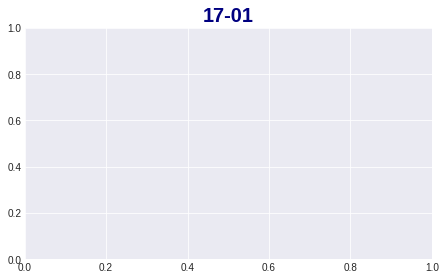

In [216]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud

party = 'FDP'

sample_df_partei = sample_df[sample_df.user_party == party]

sample_df_month = list(set(sample_df_partei['month']))
sample_df_month.sort()

date_dic_partei = {}
   
for month in sample_df_month:
    date_dic_partei[month] = sample_df_partei[sample_df_partei['month'] == month]

    
def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=4)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (18, 50))

for month, n in zip(date_dic_partei, range(1,len(date_dic_partei.keys())+1)):
    title = month

    ax = fig.add_subplot(14,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    long_string = ','.join(date_dic_partei[month]['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')

fig.suptitle(party + '_Tweets', fontsize=25, color='navy', y=1.01)

#### Wordcloud Gegenüberstellung von Parteien

/usr/local/anaconda3/bin/ipython:11: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  sys.exit(start_ipython())


AttributeError: 'list' object has no attribute 'lower'

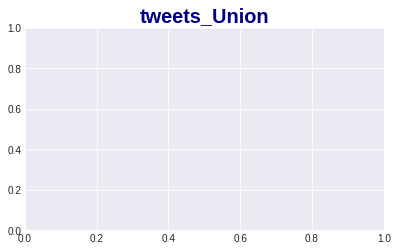

In [212]:
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from wordcloud import WordCloud


sample_df_date = sample_df.loc[(sample_df['date'] == datetime.date(2020,5,8))]

partei_dic_date = {}
for partei in parteien:
    partei_dic_date['tweets_'+ partei] = sample_df_date[sample_df['user_party'] == partei]  


def FktWordCloud(long_string):
    wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue', stopwords=stop_words, min_word_length=3)
    wordcloud.generate(long_string)
    wordcloud.to_image()
    return wordcloud

fig = plt.figure(figsize = (16, 16))
#fig.subplots_adjust(top=0.8)

for partei, n in zip(partei_dic_date, range(1,7)):
    title = str(partei)
    
    ax = fig.add_subplot(5,3,n)
    ax.set_title(title,fontweight="bold", color='navy', size=20)
    fig.tight_layout()
    sample_df_partei=partei_dic_date[partei]
    long_string = ','.join(sample_df_partei['full_text_processed'])
    wordcloud = FktWordCloud(long_string)
    ax.imshow(wordcloud)
    ax.axis('off')
fig.suptitle('Tweets 8. Mai ohne Corona', fontsize=25, color='navy', y=1.05)

In [215]:
sample_df[sample_df['date'] == datetime.date(2020,5,8)]

,_id,created_at,id,full_text,is_quote_status,retweet_count,lang,created_at_datetime,user_id,user_name,user_screen_name,user_location,user_description,user_followers_count,user_friends_count,user_created_at,user_party,full_text_processed,date,month
117262,5eb6dd0f258b117affceb01e,Fri May 08 18:01:16 +0000 2020,1258819269107896322,"Falls es noch irgendwelche Zweifel daran gab, dass die AfD Antibürgerlich und Rechtsradikal ist: https://t.co/s3Uy7kxBpw",False,86,de,2020-05-08 18:01:16,1125751445205262336,Gitta Connemann,gitta_connemann,"Hesel, Deutschland","Stellvertretende Vorsitzende der CDU/CSU-Bundestagsfraktion,",1215,134,Tue May 07 13:17:14 +0000 2019,Union,Falls es noch irgendwelche Zweifel daran gab dass die AfD Antibürgerlich und Rechtsradikal ist,2020-05-08,20-05
117348,5eb6dd55258b117affcecfb7,Fri May 08 18:21:06 +0000 2020,1258824260598009856,Das müsste jetzt nur noch jemand bemerken... https://t.co/YpwtB7EqI4,True,3,de,2020-05-08 18:21:06,574424501,M. Grosse-Brömer,MGrosseBroemer,Heide und Hauptstadt,"Mitglied des Bundestages (MP), 1. Parl. Geschäftsführer der CDU/CSU-Fraktion (chief whip of the CDU/CSU parliamentary group)",15500,395,Tue May 08 12:11:15 +0000 2012,Union,Das müsste jetzt nur noch jemand bemerken,2020-05-08,20-05
117768,5eb6dd35258b117affcebfed,Fri May 08 15:22:12 +0000 2020,1258779242139181057,"Die deutsch-französische Freundschaft ist für uns eine Herzensangelegenheit. Heute, 75 Jahre nach Kriegsende, haben wir in Scheibenhardt ein Zeichen gesetzt. Wir stehen zusammen. \n@ChSchneider \n#grenzüberschreitend\n#bettertogether https://t.co/QlWUMulD9A",False,2,de,2020-05-08 15:22:12,51483238,Thomas Gebhart MdB,thomasgebhart,Jockgrim,,2729,491,Sat Jun 27 16:33:33 +0000 2009,Union,Die deutsch-französische Freundschaft ist für uns eine Herzensangelegenheit Heute 75 Jahre nach Kriegsende haben wir in Scheibenhardt ein Zeichen gesetzt Wir stehen zusammen ChSchneider grenzüberschreitendbettertogether,2020-05-08,20-05
118301,5eb6dd7d258b117affcee983,Fri May 08 14:35:38 +0000 2020,1258767522175889408,"Geschmacklos &amp; widerlich! Die Befreiung Europas von der #Nazi-Barbarei eignet sich angesichts der #Shoa für keinen Vergleich. Der Absender @AfD, beweist einmal mehr, wessen Geistes Kind sie ist. #Vogelschiss #niewieder @CSU @csu_bt @cducsubt https://t.co/VWsLp5AR4D",False,31,de,2020-05-08 14:35:38,403735368,Florian Hahn,hahnflo,,"stv. Generalsekretär #CSU, MdB, Europa & Verteidigung, Stiftung Lebenshilfe München, FC Bayern München",4241,986,Wed Nov 02 22:47:35 +0000 2011,Union,Geschmacklos widerlich Die Befreiung Europas von der Nazi-Barbarei eignet sich angesichts der Shoa für keinen Vergleich Der Absender AfD beweist einmal mehr wessen Geistes Kind sie ist Vogelschiss niewieder CSU csu_bt cducsubt,2020-05-08,20-05
118581,5eb6dda5258b117affcf02bc,Fri May 08 20:46:45 +0000 2020,1258860915614769152,@MatthiasF8 @kahrs @spdbt @seeheimer @spdde Mein Elfenbeinturm ist ziemlich bodenständig. Aber können Sie ja nicht wissen - Sie kennen mich ja nicht wirklich.,False,0,de,2020-05-08 20:46:45,1158585210,Matthias Hauer,MatthiasHauer,Essen,Bundestagsabgeordneter 🇩🇪 | Direktmandat 🗳 | Essen 😍 und Ruhrgebiet 🏙 | Finanzen 💶 und Digitales 👨🏼‍💻 | Anwalt ⚖️ | gegen Extremismus 🔞,7773,986,Thu Feb 07 23:53:53 +0000 2013,Union,MatthiasF8 kahrs spdbt seeheimer spdde Mein Elfenbeinturm ist ziemlich bodenständig Aber können Sie ja nicht wissen - Sie kennen mich ja nicht wirklich,2020-05-08,20-05
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
415694,5ed782e50af7ab1cc9895ef3,Fri May 08 07:11:37 +0000 2020,1258655781165191169,"Der #TagDerBefreiung brachte Frieden nach Europa und beendete die Schreckensherrschaft der Nazis. Der Tag bedeutet auch Neubeginn von Demokratie, Rechtsstaat und Wirtschaftsaufschwung und legte den Grundstein für viele spätere Freundschaften Deutscher mit Menschen aus 🇺🇸&amp;🇪🇺 #8Mai",False,0,de,2020-05-08 07:11:37,808400627084705792,Danyal Bayaz,DerDanyal,Deutschland,Alman 🇩🇪 /

## Worthäufigkeiten

In [ ]:
partei_dic = {}
parteien = ['Union', 'SPD', 'Gruene', 'Linke', 'FDP', 'AFD']

for partei in parteien:
    partei_dic['tweets_'+ partei] = sample_df[sample_df['user_party'] == partei]  

In [231]:
sample_df_samp = sample_df.loc[(sample_df['created_at_datetime'] < datetime.datetime(2020,6,1,0,0,0)) & (sample_df['created_at_datetime'] >= datetime.datetime(2020,1,1,0,0,0))]

sample_df_month_samp = list(set(sample_df_samp['month']))
sample_df_month_samp.sort()

month_dic = {}
   
for month in sample_df_month_samp:
    month_dic[month] = sample_df_samp[sample_df_samp['month'] == month]

In [246]:
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

   
# Initialise the count vectorizer with the german stop words
count_vectorizer = CountVectorizer(stop_words=stop_words)


#fig = plt.figure(figsize = (16, 22))
for month, n in zip(sample_df_month_samp, range(1,len(sample_df_month_samp)+1)):
    #print(month)
    title = month
    
    # Fit and transform the processed titles
    count_data = count_vectorizer.fit_transform(month_dic[month]['full_text_processed'])
    
    words = count_vectorizer.get_feature_names()
    total_counts = np.zeros(len(words))

# for t in count_data:
#     total_counts+=t.toarray()[0] # total_counts = total_counts + t.toarray
    
# count_dict = (zip(words, total_counts))
# count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0]
#     #count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:10]
    
# words = [w[0] for w in count_dict]
# counts = [w[1] for w in count_dict]
# x_pos = np.arange(len(words))
    
# with plt.xkcd():
#     ax = fig.add_subplot(5,3,n, title =  title)
#     fig.tight_layout()
#     ax = sns.barplot(x_pos, counts, palette="GnBu_d")
#     ax.set_xticklabels(words, rotation = 45, fontsize=13)
    
# # fig.suptitle('Häufigkeit von Begriffen über alle Parteien hinweg', fontsize=25, color='darkslategray', y=1.05)
# plt.show()


20-01


/usr/local/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:385: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['wahr'] not in stop_words.
  'stop_words.' % sorted(inconsistent))


20-02
20-03
20-04
20-05
['00', '000', '000001', '001', '005', '007', '01012021', '0190', '01lambi', '02', '02062020', '03', '030', '030117', '03052020', '03621', '037', '04', '0406', '05', '0512', '06', '06052020', '0711', '0715', '08', '0804', '0815klaus', '0820', '09', '0900', '0925', '10', '100', '1000', '10000', '100000', '100000e', '10000e', '1000aqua', '1000ende', '1000m', '1001', '1008', '100e', '100euromehrsofort', '100jahre', '100mrd', '100tsd', '101', '1015', '1020', '103', '104', '105433800', '105corona', '106', '107', '1070', '107975', '108', '109000', '10gw', '10mai', '10tausende', '11', '110', '1100', '11000', '110000', '1100mrd', '111', '111k', '1120', '112020', '1130', '113fazit', '115', '117', '1192001', '11concert', '11kategorie', '11november', '11t', '12', '120', '1200', '12000', '120000', '1210', '1215', '122', '1230', '1240', '12461', '1250', '1250000', '125jahrenok', '127', '128a', '128azpo', '12euro', '12h', '12j', '12jahre', '13', '130', '1300', '1300000', '1305

# Barplot

#### Barplot Gegenüberstellung

In [242]:
#from stop_words import get_stop_words
#stop_words = get_stop_words('de')

import stopwordsiso as stopwords
stop_words = list(stopwords.stopwords(["de"])) 

mehr_sw = ['der', 'die', 'das', 'ist' 'es', 'gibt', 'und', 'für', 'auf', 'aus', 'mit', 'dem', 'tb', 'cducsubt', 'spdbt', 'fdpbt', 'sdpde'] 
           #'corona', 'covid19', 'coronakrise', 'coronavirus', 'krise']
for word in mehr_sw:
    stop_words.append(word)
    


/usr/local/anaconda3/lib/python3.7/site-packages/sklearn/feature_extraction/text.py:385: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['wahr'] not in stop_words.
  'stop_words.' % sorted(inconsistent))
findfont: Font family ['xkcd', 'xkcd Script', 'Humor Sans', 'Comic Sans MS'] not found. Falling back to DejaVu Sans.
findfont: Font family ['xkcd', 'xkcd Script', 'Humor Sans', 'Comic Sans MS'] not found. Falling back to DejaVu Sans.
findfont: Font family ['xkcd', 'xkcd Script', 'Humor Sans', 'Comic Sans MS'] not found. Falling back to DejaVu Sans.
findfont: Font family ['xkcd', 'xkcd Script', 'Humor Sans', 'Comic Sans MS'] not found. Falling back to DejaVu Sans.


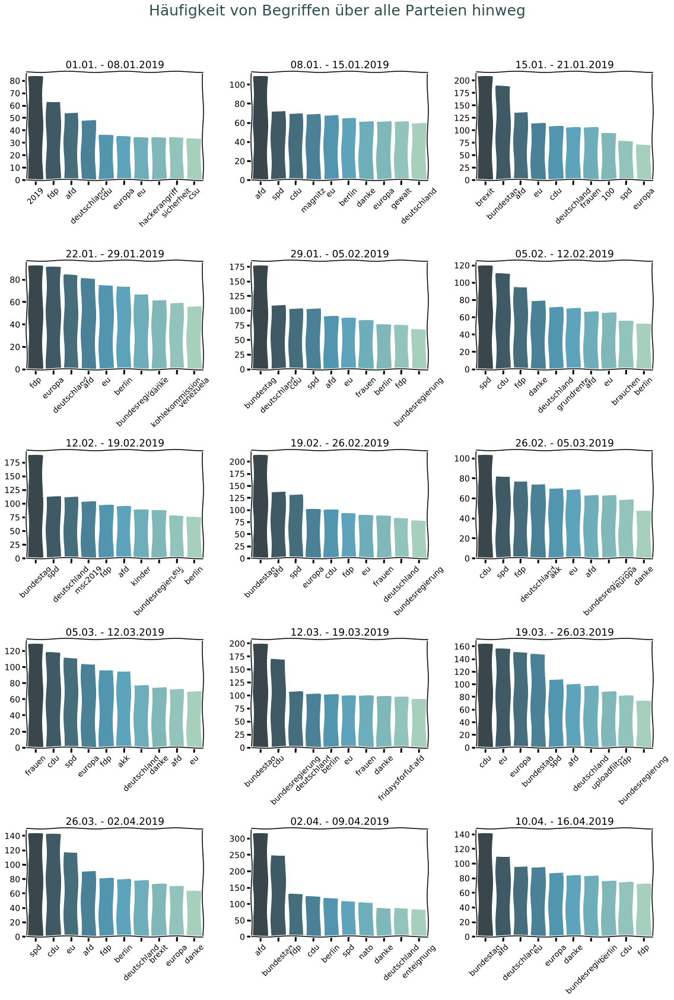

In [151]:
# Load the library with the CountVectorizer method
from sklearn.feature_extraction.text import CountVectorizer
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

# Helper function
def plot_10_most_common_words(count_data, count_vectorizer, title):
    import matplotlib.pyplot as plt
    words = count_vectorizer.get_feature_names()
    total_counts = np.zeros(len(words))
    for t in count_data:
        total_counts+=t.toarray()[0] # total_counts = total_counts + t.toarray
    
    count_dict = (zip(words, total_counts))
    count_dict = sorted(count_dict, key=lambda x:x[1], reverse=True)[0:10]
    words = [w[0] for w in count_dict]
    counts = [w[1] for w in count_dict]
    x_pos = np.arange(len(words))
    
    with plt.xkcd():
        ax = fig.add_subplot(5,3,n, title =  title)
        fig.tight_layout()
        ax = sns.barplot(x_pos, counts, palette="GnBu_d")
        ax.set_xticklabels(words, rotation = 45, fontsize=13)
        return ax

    
# Initialise the count vectorizer with the german stop words
count_vectorizer = CountVectorizer(stop_words=stop_words)


fig = plt.figure(figsize = (16, 22))
for i, n in zip(weeks, range(1,16)):
    title = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
    
    # Fit and transform the processed titles
    count_data = count_vectorizer.fit_transform(weeks[i]['full_text_processed'])
    plot_10_most_common_words(count_data, count_vectorizer, title)
    
fig.suptitle('Häufigkeit von Begriffen über alle Parteien hinweg', fontsize=25, color='darkslategray', y=1.05)
plt.show()


# Sentiment Analyse - Wörterbuch
## Simple TextBlob Analysis

In [43]:
#import nltk
#nltk.download('punkt')
from textblob_de import TextBlobDE as TextBlob

blob = TextBlob(sample_df.full_text_processed[33504]) 

# print(blob.sentences)
# print(blob.tokens)
# print(blob.tags)
# print(blob.noun_phrases)
print(blob.sentiment)

Sentiment(polarity=0.0, subjectivity=0.0)


In [44]:
# https://medium.com/@himanshu_23732/sentiment-analysis-with-textblob-6bc2eb9ec4ab
def sentiment(text):
    try:
        return TextBlob(text).sentiment
    except:
        return None
    
sample_df['Polarity']     = sample_df['full_text_processed'].apply(sentiment).apply(lambda x: x[0])
sample_df['Subjectivity'] = sample_df['full_text_processed'].apply(sentiment).apply(lambda x: x[1])
sample_df.head()

,_id,created_at,id,full_text,is_quote_status,retweet_count,lang,created_at_datetime,user_id,user_name,...,user_location,user_description,user_followers_count,user_friends_count,user_created_at,user_party,bins,full_text_processed,Polarity,Subjectivity
160213,5eb77f3a4f4fda7c5d6242fa,Sun Jan 01 00:42:42 +0000 2017,815357545942515712,Frohes neues Jahr #2017\nhttps://t.co/9LhBEbmMEH,False,0,de,2017-01-01 00:42:42,23248102,Cansel Kiziltepe,...,Berlin,"Ökonomin, Politikerin #MdB @spdbt #berlin #xhain #spdxhain #PBerg #wk83 #KiezkindCansel #kiezregiert",6312,1421,Sat Mar 07 23:27:23 +0000 2009,SPD,1,Frohes neues Jahr 2017,1.00,0.0
204397,5eb791a12c0dd47b69080836,Sun Jan 01 08:14:50 +0000 2017,815471330057474048,"Hätte gewünscht, dass #2017 besser startet als #2016 #Istanbul @SenyurtSinan. Gedanken bei den Opfern! #üzgüngece",False,1,de,2017-01-01 08:14:50,22125770,Ekin Deligöz,...,,MdB @GrueneBundestag aus #Neu_Ulm | Sprecherin der Bayrischen Landesgruppe | Mitglied #Haushaltsausschuss | Obfrau #Rechnungsprüfungsausschuss,7666,1297,Fri Feb 27 09:59:05 +0000 2009,Gruene,1,Hätte gewünscht dass 2017 besser startet als 2016 Istanbul SenyurtSinan Gedanken bei den Opfern üzgüngece,0.00,0.0
98687,5e95a104dc45db2183f9ea3f,Sun Jan 01 09:14:16 +0000 2017,815486287104851968,Alles Gute im neuen Jahr! Das Wahljahr beginnt für mich um 11 Uhr bei der CDU Korntal im Bürgertreff in der Görlitzstraße. Herzl. Einladung!,False,0,de,2017-01-01 09:14:16,23925041,Steffen Bilger,...,Ludwigsburg / Berlin,"MdB Wahlkreis Ludwigsburg, Parlamentarischer Staatssekretär im @BMVI, Vorsitzender CDU Nordwürttemberg",4777,771,Thu Mar 12 09:30:05 +0000 2009,Union,1,Alles Gute im neuen Jahr Das Wahljahr beginnt für mich um 11 Uhr bei der CDU Korntal im Bürgertreff in der Görlitzstraße Herzl Einladung,0.00,0.0
334061,5ed76f53a196a3b4575d6043,Sun Jan 01 09:14:37 +0000 2017,815486374086381572,https://t.co/sJoSZUueUc,False,0,und,2017-01-01 09:14:37,46498076,Mathias_Stein,...,,"Bundestagsabgeordneter (SPD) aus Kiel, Mitglied im Verkehrsausschuss #Radverkehr #EMobilität #Binnenschifffahrt",1402,932,Thu Jun 11 21:36:58 +0000 2009,SPD,1,,0.00,0.0
107580,5e95a302dc45db2183fb82fc,Sun Jan 01 09:38:05 +0000 2017,815492279398006784,Alles Gute im neuen Jahr! https://t.co/4pbjFX0QVm,False,0,de,2017-01-01 09:38:05,368334555,Patrick Schnieder,...,Arzfeld/Eifel,"Bundestagsabgeordneter, Parlamentarischer Geschäftsführer der CDU/CSU-Bundestagsfraktion, direkt gewählt im Wahlkreis 202 Bitburg",4062,1052,Mon Sep 05 13:31:39 +0000 2011,Union,1,Alles Gute im neuen Jahr,0.00,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
379458,5ed773e40af7ab1cc988656f,Wed Jun 03 09:44:42 +0000 2020,1268116388075450370,@fuchsgruen @KlaraSche @HinrichWe War wie immer schön mit Euch :-) 👏👏👏,False,0,de,2020-06-03 09:44:42,569166756,Lisa Paus,...,Charlottenburg-Wilmersdorf,"@GrueneBundestag Sprecherin für Finanzpolitik, Feministin 💜 Mama 👩‍👦 Grüne 🌻 🇪🇺 #Greenfinance #taxjustice #Immobilienspekulation #Geldwäsche",8120,1970,Wed May 02 12:57:06 +0000 2012,Gruene,70,fuchsgruen KlaraSche HinrichWe War wie immer schön mit Euch - 👏👏👏,1.00,0.0
372432,5ed7735c7a23e3b2cd610790,Wed Jun 03 09:47:17 +0000 2020,1268117042189807616,"Wer Millionen Muslime im eigenen Land einsperrt, sollte sich mit Ratschlägen zu Menschenrechten zurückhalten. https://t.co/bFAaCQfj7i",True,0,de,2020-06-03 09:47:17,17535941,Christian Dürr,...,Berlin / Ganderkesee,"Fraktions-Vize bei der @fdpbt, zuständig für Haushalt & Finanzen",3929,1050,Fri Nov 21 13:20:23 +0000 2008,FDP,70,Wer Millionen Muslime im eigenen Land einsperrt sollte sich mit Ratschlägen zu Menschenrechten zurückhalten,1.00,0.0
383807,5ed774567a23e3b2cd615e58,Wed Jun 03 09:49:34 +0000 2020,1268117615551053827,Italienische Corona App läuft sogar auf Deutsch. Die aus ihrer CDU /SPD Bundesregierung nicht. Zu lahm! https://t.co/VkqvFGQpi9 https://t.co/nTbp5CqcSy,True,1,de,2020-06-03 09:49:34,1085494381405237251,Dr. forest Christoph Hoffmann,...,"

In [45]:
# compute sentiment scores (polarity) and labels
sentiment_scores = sample_df['Polarity']
sentiment_category = ['positive' if score > 0 
                             else 'negative' if score < 0 
                                 else 'neutral' 
                                     for score in sentiment_scores]


# sentiment statistics per news category
df_weeks = pd.DataFrame([list(sample_df['bins']), list(sample_df['user_party']), list(sentiment_scores), list(sentiment_category)]).T
df_weeks.columns = ['bins', 'partei', 'sentiment_score', 'sentiment_category']
df_weeks['sentiment_score'] = df_weeks.sentiment_score.astype('float')
df_weeks.groupby(by=['partei']).describe()

sentiment_score                                                  
                 count      mean       std  min  25%  50%       75%  max
partei                                                                  
AFD     46247.0         0.084745  0.548325 -1.0  0.0  0.0  0.466667  1.0
FDP     67310.0         0.154663  0.523485 -1.0  0.0  0.0  0.700000  1.0
Gruene  74482.0         0.168855  0.523026 -1.0  0.0  0.0  0.700000  1.0
Linke   63629.0         0.100430  0.536506 -1.0  0.0  0.0  0.500000  1.0
SPD     86843.0         0.227314  0.508437 -1.0  0.0  0.0  0.700000  1.0
Union   73655.0         0.225697  0.516635 -1.0  0.0  0.0  0.700000  1.0

In [53]:
len(weeks)

70

['01.01. - 18.01.2017', '18.01. - 05.02.2017', '05.02. - 23.02.2017', '23.02. - 13.03.2017', '13.03. - 31.03.2017', '31.03. - 18.04.2017', '18.04. - 05.05.2017', '05.05. - 23.05.2017', '23.05. - 10.06.2017', '10.06. - 28.06.2017', '28.06. - 16.07.2017', '16.07. - 03.08.2017', '03.08. - 21.08.2017', '21.08. - 07.09.2017', '07.09. - 25.09.2017', '25.09. - 13.10.2017', '13.10. - 31.10.2017', '31.10. - 18.11.2017', '18.11. - 06.12.2017', '06.12. - 23.12.2017', '24.12. - 10.01.2018', '10.01. - 28.01.2018', '28.01. - 15.02.2018', '15.02. - 05.03.2018', '05.03. - 23.03.2018', '23.03. - 10.04.2018', '10.04. - 27.04.2018', '28.04. - 15.05.2018', '15.05. - 02.06.2018', '02.06. - 20.06.2018', '20.06. - 08.07.2018', '08.07. - 26.07.2018', '26.07. - 12.08.2018', '13.08. - 30.08.2018', '30.08. - 17.09.2018', '17.09. - 05.10.2018', '05.10. - 23.10.2018', '23.10. - 10.11.2018', '10.11. - 27.11.2018', '28.11. - 15.12.2018', '15.12. - 02.01.2019', '02.01. - 20.01.2019', '20.01. - 07.02.2019', '07.02. - 

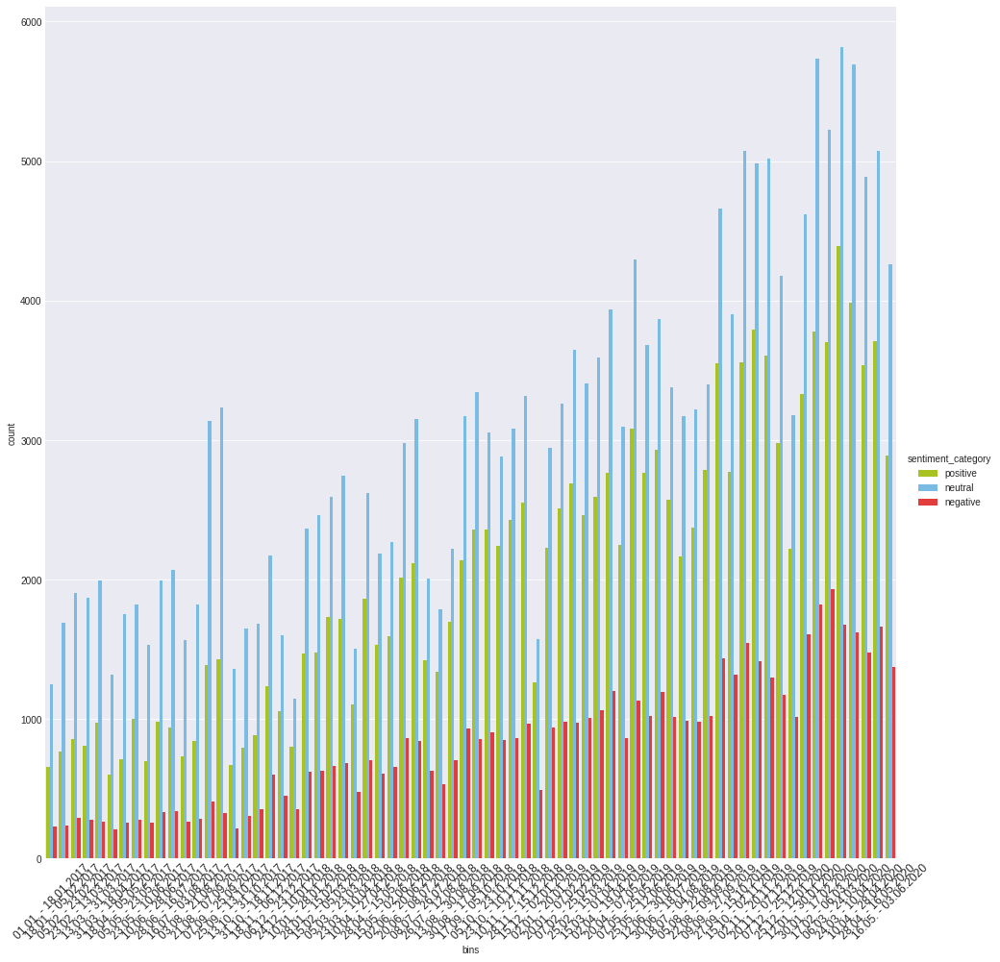

In [54]:
import matplotlib.pyplot as plt
import seaborn as sns

labels = []


for i, n in zip(weeks, range(1,len(weeks)+1)):
    label = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
    labels.append(label)
    
ax = sns.catplot(x="bins", hue="sentiment_category", height=13,
                    data=df_weeks, kind="count", 
                    palette={"negative": "#FE2020", 
                             "positive": "#BADD07", 
                             "neutral": "#68BFF5"})
ax.set_xticklabels(labels, rotation = 45, fontsize=12)

#print(labels)

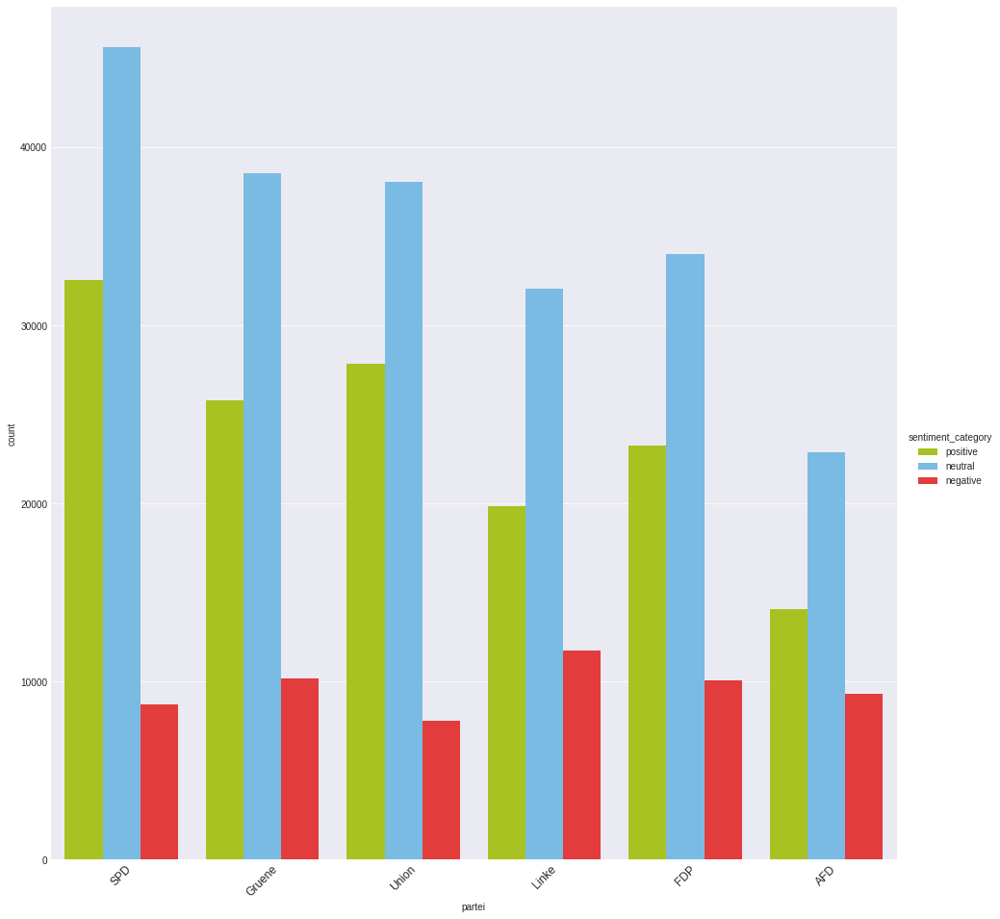

In [47]:
ax = sns.catplot(x="partei", hue="sentiment_category", height=13,
                    data=df_weeks, kind="count", 
                    palette={"negative": "#FE2020", 
                             "positive": "#BADD07", 
                             "neutral": "#68BFF5"})
ax.set_xticklabels(rotation = 45, fontsize=12)

Text(0.5, 1.05, 'Häufigkeit von von pos, neg und neut Tweets nach Parteien')

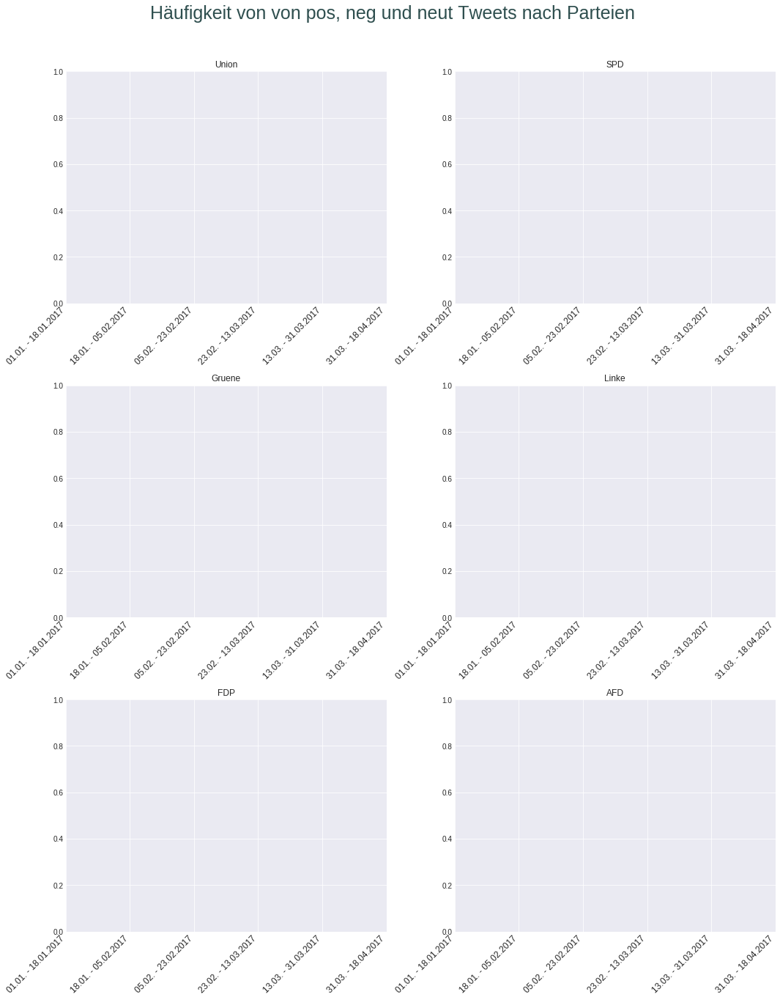

In [56]:
partei_dic_sent = {}
for partei in parteien:
    partei_dic_sent['sentiment_'+ partei] = df_weeks[df_weeks['partei'] == partei]  
    
for i, n in zip(weeks, range(1,len(weeks)+1)):
    label = "%s - %s" % (bin_sum_per_week[n]['Von'].strftime('%d.%m.'),
                         bin_sum_per_week[n]['Bis'].strftime('%d.%m.%Y'))
    labels.append(label)

fig = plt.figure(figsize = (15, 18))

for partei, n in zip(parteien, range(1,7)):
    ax = fig.add_subplot(3,2,n, title = partei)
    fig.tight_layout()
    sns.catplot(x="bins", hue="sentiment_category", data=partei_dic_sent['sentiment_'+partei], kind="count", palette={"negative": "#FE2020", "positive": "#BADD07", "neutral": "#68BFF5"}, ax=ax)
    ax.set_xticklabels(labels, rotation = 45, fontsize=12, ha='right')
    plt.close(2)
    
fig.suptitle('Häufigkeit von von pos, neg und neut Tweets nach Parteien', fontsize=25, color='darkslategray', y=1.05)

In [57]:
partei_dic_sent['sentiment_FDP']

,bins,partei,sentiment_score,sentiment_category
24,1,FDP,0.000000,neutral
39,1,FDP,0.000000,neutral
57,1,FDP,0.000000,neutral
67,1,FDP,0.000000,neutral
86,1,FDP,0.733333,positive
...,...,...,...,...
412159,70,FDP,0.000000,neutral
412160,70,FDP,0.700000,positive
412162,70,FDP,1.000000,positive
412163,70,FDP,-1.000000,negative


## Basic Emotions
##### 1.) Erstellen der EmotionsMatrix

In dieser Matrix steht jede Zeile für ein deutsches Wort, welches den Wert 1 zugeschrieben bekommt, wenn eine der sieben "Basis Emotionen" damit verbunden ist.

In [59]:
%%time
import pandas as pd
from nltk import word_tokenize
from nltk.stem.snowball import SnowballStemmer
from tqdm import tqdm


import csv
import numpy as np
import pandas as pd

pd.set_option('display.max_colwidth', 0)
    
######### Erstelle Emotions-Matrix

filepath = '/home/lisa/Darmstadt/Master Arbeit/06_Analyse/Lexicon_based/german-emotion-dictionary/fundamental/'
emo_df = []
words = []
emotion = ['Ekel', 'Freude', 'Furcht', 'Trauer', 'Ueberraschung', 'Verachtung', 'Wut']
emotion_list= {}
stemmer = SnowballStemmer("german")

for emo in emotion:
    with open(filepath + emo + '.txt', newline='\n') as f:
        reader = csv.reader(f)
        data = [item for sublist in reader for item in sublist] 
        emotion_list[str(emo)] = data
        words.extend(data)
        
words = list(set(words)) # remove Duplicates which come from overlapping EmotionLists
emo_df  = pd.DataFrame(index=words, columns=emotion)

words = []
for word in emo_df.index:
    for emo in emo_df.columns:
        if word in emotion_list[emo]:
            emo_df.at[word, emo] = 1
        else:
            emo_df.at[word, emo] = 0
    words.append(stemmer.stem(word.lower()))
 
emo_df.index= words
emo_df = emo_df.sort_index(ascending=True)
emo_df = pd.DataFrame(emo_df)
emo_df = emo_df.loc[~emo_df.index.duplicated(keep='first')]

emo_df.head()


CPU times: user 967 ms, sys: 56.2 ms, total: 1.02 s
Wall time: 1.29 s


,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut
aalglatt,0,0,0,0,0,1,0
aasgei,0,0,0,0,0,1,0
abbrech,0,0,0,1,0,0,0
abbruchreif,0,0,0,0,0,1,0
abbugeln,0,0,0,0,0,1,0


##### Check ob bestimmtes Wort in Matrix enthalten ist

In [63]:
emo_df.loc[emo_df.index == 'angst']

,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut
angst,0,0,1,0,0,0,0


#### 2.) Anwendung der Emotions Matrix auf den Twitter Datensatz
Jedes Wort in jedem Tweet wird in der Matrix gesucht und ggf. der Vektor zurückgegeben. 
Siehe Kommentare

In [61]:
%%time
#from fuzzywuzzy import fuzz
emo_base_df = sample_df['full_text_processed']
df_emo = pd.DataFrame(0, index=emo_base_df.index, columns=emotion)

for i in emo_base_df.index:
    document = word_tokenize(emo_base_df.loc[i])
    for word in document:
        word = stemmer.stem(word.lower())             # Stemming des einzelnen Wortes aus Tweet um es...
        emo_score = emo_df[emo_df.index == word]      # ... mit den Lexikon Worten zu vergleichen -> emo_score 

#         for w in emo_df.index:
#             fuz = fuzz.ratio(str(w), word)
#             if fuz > 98:
#                 emo_score = emo_df[emo_df.index == w].drop_duplicates(keep = 'first')    

        if not emo_score.empty:                       # der emo score eines Worts z.B. [0 0 1 1 0 0 0] 
            for emot in emotion:                      # wird zum Score des Tweets dazugezählt z.B.: [2 0 4 1 0 0 0]
                df_emo.at[i, emot] += emo_score[emot] # am Ende exisitiert zu einem Tweet ein 7-dim Vektor
                

emo_base_df = pd.concat([emo_base_df, df_emo], axis=1)

emo_base_df.head(20)

CPU times: user 1h 9min 54s, sys: 4.93 s, total: 1h 9min 59s
Wall time: 1h 9min 44s


,full_text_processed,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut
0,Alles schon geregelt,0,0,0,0,0,1,0
1,Herr Schneider es sind 11% und wer hat bisher in der CDU das sagen gehabt Eine Frau Jetzt müssen wieder gestandene Männer an die Macht Die AFD wird das 2020 machen,0,0,0,0,0,0,0
2,Deshalb fordern wir auf Autobahnen ein Tempolimet von 80 Stundenkilometern,0,0,0,0,0,0,0
3,Wer will dich denn schon bedrohen Linke Socke,0,0,1,0,0,2,0
4,AfdBystron wieso sagst du nicht das ich dein Bruder bin afdwirkt Alice_Weidel Joerg_Meuthen mutzurwahrheit,0,1,0,0,0,0,0
5,Und du sei auch vorsichtig,0,0,0,0,0,0,0
6,Moin,0,0,0,0,0,0,0
7,5 G wird es nur für uns von der AFD geben,0,0,0,0,0,0,0
8,Alice_Weidel Bitte treten Sie aus unserer Partei aus Danke,0,0,0,1,0,0,0
9,So ich habe einen neuen Account weil die Twitterbande mich gesperrt haben Ich bin der Bystron von der AFD für Deutschland,0,0,0,0,1,0,0


In [76]:
emo_base_df.to_csv(index=False)

In [65]:
#### Add Timestamp
# -> In Grafiken später mit abgebildet

emo_base_df['Partei'] = sample_df['user_party']
emo_base_df['created_at_datetime'] = sample_df['created_at_datetime']
emo_base_df.head(5)

,full_text_processed,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut,Partei,created_at_datetime
0,Alles schon geregelt,0,0,0,0,0,1,0,AFD,2019-02-22 15:10:38
1,Herr Schneider es sind 11% und wer hat bisher in der CDU das sagen gehabt Eine Frau Jetzt müssen wieder gestandene Männer an die Macht Die AFD wird das 2020 machen,0,0,0,0,0,0,0,AFD,2019-02-22 14:37:27
2,Deshalb fordern wir auf Autobahnen ein Tempolimet von 80 Stundenkilometern,0,0,0,0,0,0,0,AFD,2019-02-22 14:29:01
3,Wer will dich denn schon bedrohen Linke Socke,0,0,1,0,0,2,0,AFD,2019-02-22 14:27:49
4,AfdBystron wieso sagst du nicht das ich dein Bruder bin afdwirkt Alice_Weidel Joerg_Meuthen mutzurwahrheit,0,1,0,0,0,0,0,AFD,2019-02-22 12:11:18


##### Begrenze die Auswahl von relevanten Tweets -> emo_base_select

In [66]:
emo_base_select = emo_base_df
# emo_base_select = emo_base_df[emo_base_df['full_text_processed'].str.match(r'.*((?i)corona|(?i)Covid).*')==True]
# len(emo_base_select[emo_base_select['Partei']=='Gruene'])
# len(emo_base_select)

####  3.) Remove empty full_text_processed
Wenn z.B. nur ein Link und emojis gepostet wurden ist nach dem text cleaning die Zelle leer (aber nicht isnull() == true)

In [67]:
emo_base_text = emo_base_df.drop(emo_base_select[emo_base_select['full_text_processed']==''].index)
emo_base_text = emo_base_text.drop(emo_base_text[emo_base_text['full_text_processed']==' '].index)
emo_base_text = emo_base_text.drop(emo_base_text[emo_base_text['full_text_processed']=='  '].index)
emo_base_text = emo_base_text.drop(emo_base_text[emo_base_text['full_text_processed']=='   '].index)

In [68]:
emo_party = emo_base_text.groupby('Partei').sum()
emo_party.head()

,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut
Partei,,,,,,,
AFD,1045,10262,7093,6583,4711,17022,3971
FDP,1057,15892,6368,9693,7764,17917,3484
Gruene,1328,21352,7392,9793,8899,17661,4232
Linke,1383,15053,8780,9213,6468,20834,4296
SPD,1363,30174,7730,9956,8483,17542,4095


#### 4.) Relativieren von Werten
1.) Teile durch Länge (Wordcount) des Tweets

In [69]:
from nltk import tokenize
from nltk import word_tokenize

emo_base_rel=emo_base_text

emo_base_rel['word_count'] = emo_base_rel['full_text_processed'].apply(tokenize.word_tokenize).apply(len)

for emo in emotion:
    emo_base_rel[emo] = emo_base_rel[emo] / emo_base_rel['word_count']
emo_base_rel.head()

,full_text_processed,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut,Partei,created_at_datetime,word_count
0,Alles schon geregelt,0.0,0.000000,0.000,0.0,0.0,0.333333,0.0,AFD,2019-02-22 15:10:38,3
1,Herr Schneider es sind 11% und wer hat bisher in der CDU das sagen gehabt Eine Frau Jetzt müssen wieder gestandene Männer an die Macht Die AFD wird das 2020 machen,0.0,0.000000,0.000,0.0,0.0,0.000000,0.0,AFD,2019-02-22 14:37:27,32
2,Deshalb fordern wir auf Autobahnen ein Tempolimet von 80 Stundenkilometern,0.0,0.000000,0.000,0.0,0.0,0.000000,0.0,AFD,2019-02-22 14:29:01,10
3,Wer will dich denn schon bedrohen Linke Socke,0.0,0.000000,0.125,0.0,0.0,0.250000,0.0,AFD,2019-02-22 14:27:49,8
4,AfdBystron wieso sagst du nicht das ich dein Bruder bin afdwirkt Alice_Weidel Joerg_Meuthen mutzurwahrheit,0.0,0.071429,0.000,0.0,0.0,0.000000,0.0,AFD,2019-02-22 12:11:18,14


2.) Teile durch die Menge der Tweets pro Partei

In [ ]:
# 2.) Teilen durch Gesammtzahl an Tweets pro Partei #### bringt nicht die richtigen Ergebnisse

# emo_party_rel_0 = emo_base_rel.groupby('Partei').sum().apply(lambda x: x/float(x.count()))
# emo_party_rel_0.head()

In [72]:
# 2.) Teilen durch Gesammtzahl an Tweets pro Partei #### umständliche aber korrekte Version
emo_party_sum = emo_base_rel.groupby('Partei').sum()
emo_party_count = emo_base_rel.groupby('Partei').count()
emo_party_rel_1 = emo_party_sum/ emo_party_count
emo_party_rel_1

,Ekel,Freude,Furcht,Trauer,Ueberraschung,Verachtung,Wut,created_at_datetime,full_text_processed,word_count
Partei,,,,,,,,,,
AFD,0.001065,0.011692,0.006563,0.006454,0.005264,0.017172,0.003761,NaN,NaN,22.071493
FDP,0.000723,0.013490,0.003995,0.006990,0.005422,0.012841,0.002161,NaN,NaN,21.625175
Gruene,0.000891,0.018638,0.004345,0.006094,0.006105,0.011783,0.002515,NaN,NaN,20.744097
Linke,0.001107,0.013622,0.005892,0.006400,0.005083,0.015444,0.002925,NaN,NaN,22.552562
SPD,0.000860,0.025323,0.003790,0.005557,0.005561,0.011215,0.002153,NaN,NaN,19.374325
Union,0.000743,0.022654,0.003338,0.005192,0.006022,0.011817,0.002108,NaN,NaN,19.672202


##### Spaghetti Plot

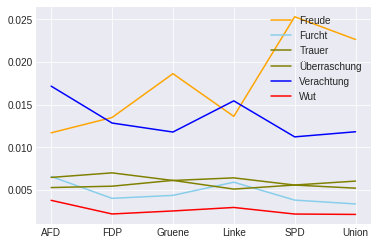

In [71]:
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns

plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[1], data=emo_party_rel_1, color='orange')
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[2], data=emo_party_rel_1, color='skyblue')
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[3], data=emo_party_rel_1, color='olive')
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[4], data=emo_party_rel_1, color='olive',label="Überraschung")
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[5], data=emo_party_rel_1, color='blue')
plt.plot( emo_party_rel_1.index, emo_party_rel_1.columns[6], data=emo_party_rel_1, color='red')
plt.legend()


ValueError: Unrecognized character E in format string

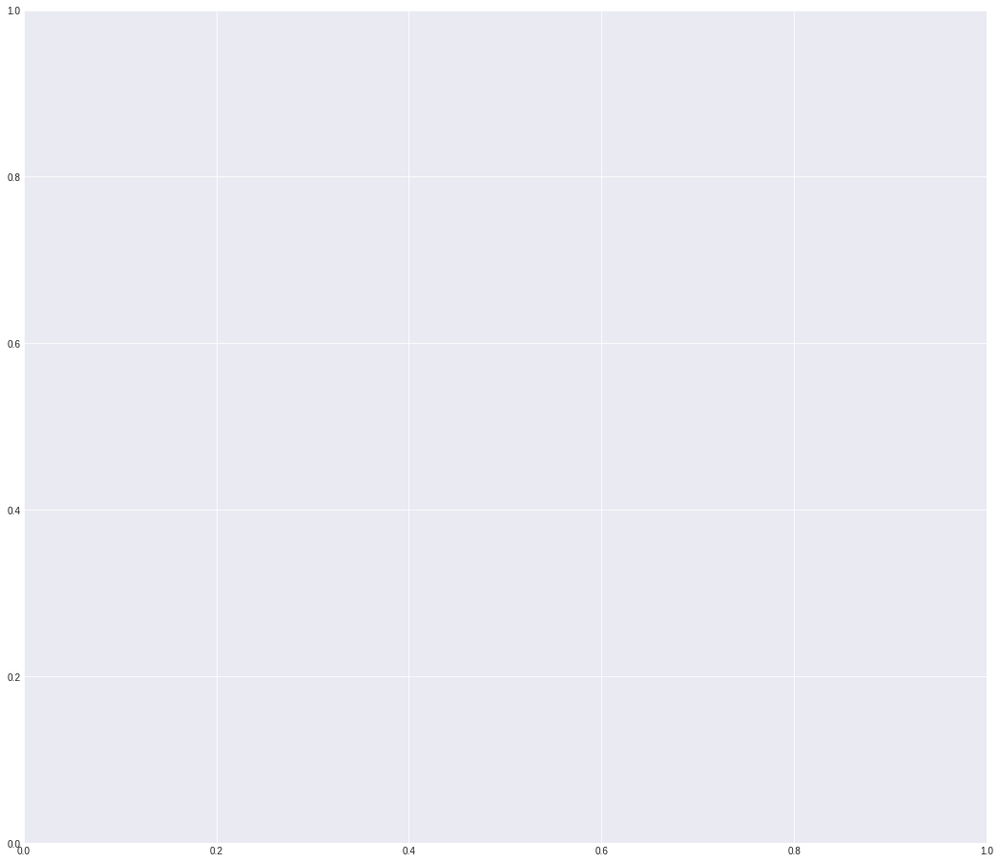

In [75]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd
import numpy as np

plt.style.use('seaborn-darkgrid')
my_palette = ['blue', 'orange', 'green', 'purple', 'red', 'black']

fig = plt.figure(figsize = (18, 16))
ax = fig.add_subplot(111)

# num=0
# for column in partei_piv['full_text']:
#     ax.plot(partei_piv.index, partei_piv['full_text'][column], color = my_palette[num], alpha=0.7, label = column)
#     num+=1

num=0
for column in emo_party_rel_1:
    ax.plot(emo_party_rel_1.index, column, color = my_palette[num], alpha=0.7, label = column)
    num+=1
    
# ylab = ax.set_ylabel('Tweets pro Partei', size = 20)
# # = ax.set_xlabel('Datum', size = 20)
# plt.legend(loc = 2, ncol = 2, fontsize = 17)

# # y_tags
# # ytag = ax.set_yticklabels(np.arange(partei_piv.values.min()-51, partei_piv.values.max()+50, 50), fontsize = 18)
# # ytag = ax.set_yticklabels(np.arange(partei_piv.values.min()-90, partei_piv.values.max(), 200), fontsize = 18)

# #x_tags
# xtag = ax.set_xticklabels(partei_piv.index, fontsize = 14, rotation = 45)

# # months = mdates.MonthLocator()
# # months_fmt = mdates.DateFormatter('%b-%Y')

# # ax.xaxis.set_major_locator(months)
# # ax.xaxis.set_major_formatter(months_fmt)





#### Radar Charts

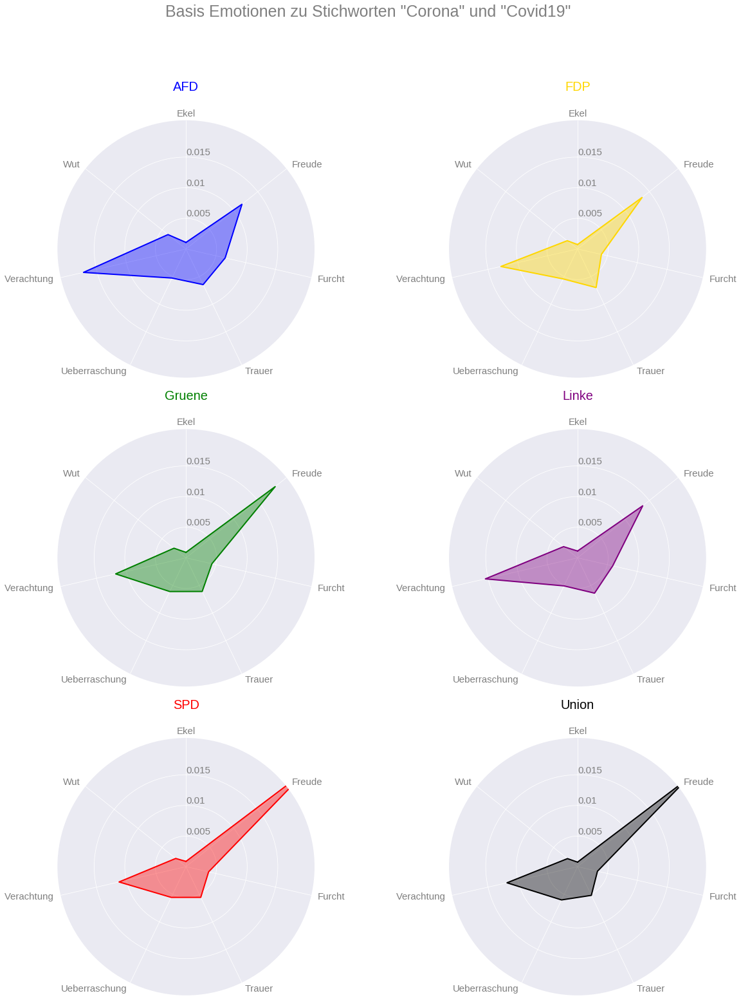

In [74]:
## https://python-graph-gallery.com/392-use-faceting-for-radar-chart/
# Libraries
import matplotlib.pyplot as plt
import pandas as pd
from math import pi
 
# ------- PART 1: Define a function that do a plot for one line of the dataset!
 
def make_spider(row, title, color):
    # number of variable
    categories=list(df)[0:]
    N = len(categories)
 
    # What will be the angle of each axis in the plot? (we divide the plot / number of variable)
    angles = [n / float(N) * 2 * pi for n in range(N)]
    angles += angles[:1]
 
    # Initialise the spider plot
    ax = plt.subplot(3,2,row+1, polar=True, )

    # If you want the first axis to be on top:
    ax.set_theta_offset(pi / 2)
    ax.set_theta_direction(-1)

    # Draw one axe per variable + add labels labels yet #https://www.pythoncharts.com/2019/04/16/radar-charts/
    plt.xticks(angles[:-1], categories, color='grey', size=15)
    for label, angle in zip(ax.get_xticklabels(), angles):
        if angle in (0, np.pi):
            label.set_horizontalalignment('center')
        elif 0 < angle < np.pi:
            label.set_horizontalalignment('left')
        else:
            label.set_horizontalalignment('right')
 
    # Draw ylabels
    ax.set_rlabel_position(0)
    plt.yticks([0.005,0.01,0.015], ['0.005','0.01','0.015'], color="grey", size=15)
    plt.ylim(0,0.021)

    # Ind1
    values=df.loc[df.index[row]].values.flatten().tolist()
    values += values[:1]
    ax.plot(angles, values, color=color, linewidth=2, linestyle='solid')
    ax.fill(angles, values, color=color, alpha=0.4)

    # Add a title
    plt.title(title, size=20, color=color, y=1.1)
 

# ------- PART 2: Apply to all individuals
# initialize the figure

df=emo_party_rel_1[emo_party_rel_1.columns[0:7]]

fig = plt.figure(figsize=(20, 25))
fig.tight_layout()
fig.suptitle('Basis Emotionen zu Stichworten "Corona" und "Covid19" ', color="grey", size=25)
 
# Create a color palette:
my_palette = plt.cm.get_cmap("Set2", len(df.index))
my_palette = ['blue', 'gold', 'green', 'purple', 'red', 'black']
 
# Loop to plot
for row in range(0, len(df.index)):
    make_spider( row=row, title=df.index[row], color=my_palette[row])

In [ ]:
values=df.loc[df1.index[row]].values.flatten().tolist()
values += values[:1]
values

In [ ]:
df.loc[df1.index[row]]